<h1>ML3 Individual Technical Report</h1>

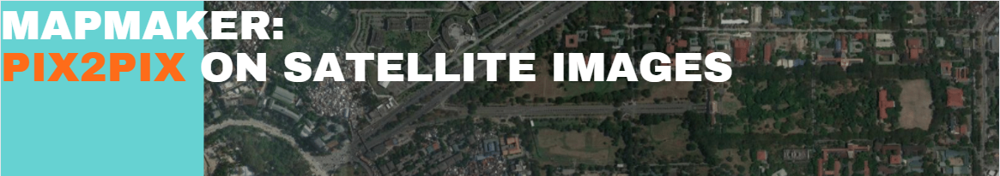

In [7]:
from IPython.display import Image
display(Image(filename="title.PNG"))

In [9]:
from IPython.display import HTML

HTML('''<script>
code_show=true; 
function code_toggle() {
 if (code_show){
 $('div.input').hide();
 } else {
 $('div.input').show();
 }
 code_show = !code_show
} 
$( document ).ready(code_toggle);
</script>
<style>
.output_png {
    display: table-cell;
    text-align: center;
    horizontal-align: middle;
    vertical-align: middle;
    margin:auto;
}

tbody, thead {
    margin-left:100px;
}

</style>
<form action="javascript:code_toggle()"><input type="submit"
value="Click here to toggle on/off the raw code."></form>''')

In [10]:
# Import libraries
import os
import numpy as np
import seaborn as sns
import pandas as pd
from matplotlib import pyplot
from matplotlib.pyplot import figure

from os import listdir
from numpy import load
from numpy import zeros
from numpy import ones
from numpy import vstack
from numpy import asarray
from numpy import savez_compressed
from numpy.random import randint

from keras.preprocessing.image import img_to_array
from keras.preprocessing.image import load_img

from keras.models import Model
from keras.models import Input
from keras.layers import Conv2D
from keras.layers import Dropout
from keras.layers import LeakyReLU
from keras.models import load_model
from keras.layers import Activation
from keras.layers import Concatenate
from keras.layers import Conv2DTranspose
from keras.layers import BatchNormalization
from keras.initializers import RandomNormal
from tensorflow.keras.optimizers import Adam

In [11]:
# Compilation of functions used.
# Most of function patterned from the Reference [1]

# image loading for training.

def load_real_samples(filename):
    '''
    Load and prepare training images saved in an npz file.
    '''
    # load compressed arrays
    data = load(filename)
    
    # unpack arrays
    X1, X2 = data['arr_0'], data['arr_1']
    
    # scale from [0,255] to [-1,1]
    X1 = (X1 - 127.5) / 127.5
    X2 = (X2 - 127.5) / 127.5
    
    return [X1, X2]

# plot resulting images

def plot_images(src_img, gen_img, tar_img):
    '''
    Plot source, expectyed and resulting images side by side.
    '''
    images = vstack((src_img, gen_img, tar_img))
    # scale from [-1,1] to [0,1]
    images = (images + 1) / 2.0
    titles = ['Source', 'Generated', 'Expected']
    # plot images row by row
    figure(figsize=(16, 12), dpi=120)
    for i in range(len(images)):
        # define subplot
        pyplot.subplot(1, 3, 1 + i)
        # turn off axis
        pyplot.axis('off')
        # plot raw pixel data
        pyplot.imshow(images[i])
        # show title
        pyplot.title(titles[i])
    pyplot.show()

# image generation

def generate_real_samples(dataset, n_samples, patch_shape):
    '''
    Select a batch of random samples and returns images and target as real
    samples.
    '''
    # unpack dataset
    trainA, trainB = dataset
    
    # choose random instances
    ix = randint(0, trainA.shape[0], n_samples)
    
    # retrieve selected images
    X1, X2 = trainA[ix], trainB[ix]
    
    # generate 'real' class labels (1)
    y = ones((n_samples, patch_shape, patch_shape, 1))
    
    return [X1, X2], y

def generate_fake_samples(g_model, samples, patch_shape):
    '''
    Generate a batch of images, returns images and targets as fake samples
    '''
    # generate fake instance
    X = g_model.predict(samples)
    
    # create 'fake' class labels (0)
    y = zeros((len(X), patch_shape, patch_shape, 1))
    
    return X, y

# define the model components

def define_encoder_block(layer_in, n_filters, batchnorm=True):
    '''
    Defines the encoder.
    '''
    # weight initialization
    init = RandomNormal(stddev=0.02)
    
    # add downsampling layer
    g = Conv2D(n_filters, (4,4), strides=(2,2), padding='same', 
               kernel_initializer=init)(layer_in)
    
    # conditionally add batch normalization
    if batchnorm:
        g = BatchNormalization()(g, training=True)
    
    # leaky relu activation
    g = LeakyReLU(alpha=0.2)(g)
    
    return g
 
def decoder_block(layer_in, skip_in, n_filters, dropout=True):
    '''
    Defiens the decoder. U-net setup with skip connections.
    '''
    # weight initialization
    init = RandomNormal(stddev=0.02)
    
    # add upsampling layer
    g = Conv2DTranspose(n_filters, (4,4), strides=(2,2), padding='same', 
                        kernel_initializer=init)(layer_in)
    # add batch normalization
    g = BatchNormalization()(g, training=True)
    
    # conditionally add dropout
    if dropout:
        g = Dropout(0.5)(g, training=True)
    
    # merge with skip connection
    g = Concatenate()([g, skip_in])
    
    # relu activation
    g = Activation('relu')(g)
    
    return g
 
def define_generator(image_shape=(256,256,3)):
    '''
    Defines the whole generator, encoder + decoder.
    '''
    # weight initialization
    init = RandomNormal(stddev=0.02)
    
    # image input
    in_image = Input(shape=image_shape)
    
    # encoder model
    e1 = define_encoder_block(in_image, 64, batchnorm=False)
    e2 = define_encoder_block(e1, 128)
    e3 = define_encoder_block(e2, 256)
    e4 = define_encoder_block(e3, 512)
    e5 = define_encoder_block(e4, 512)
    e6 = define_encoder_block(e5, 512)
    e7 = define_encoder_block(e6, 512)
    
    # bottleneck, no batch norm and relu
    b = Conv2D(512, (4,4), strides=(2,2), padding='same', 
               kernel_initializer=init)(e7)
    b = Activation('relu')(b)
    
    # decoder model
    d1 = decoder_block(b, e7, 512)
    d2 = decoder_block(d1, e6, 512)
    d3 = decoder_block(d2, e5, 512)
    d4 = decoder_block(d3, e4, 512, dropout=False)
    d5 = decoder_block(d4, e3, 256, dropout=False)
    d6 = decoder_block(d5, e2, 128, dropout=False)
    d7 = decoder_block(d6, e1, 64, dropout=False)
    
    # output
    g = Conv2DTranspose(3, (4,4), strides=(2,2), padding='same', 
                        kernel_initializer=init)(d7)
    out_image = Activation('tanh')(g)
    
    # define model
    model = Model(in_image, out_image)
    
    return model

# define the discriminator model

def define_discriminator(image_shape):
    '''
    Define the discriminator model following a patchGAN model.
    '''
    # weight initialization
    init = RandomNormal(stddev=0.02)
    
    # source image input
    in_src_image = Input(shape=image_shape)
    
    # target image input
    in_target_image = Input(shape=image_shape)
    
    # concatenate images channel-wise
    merged = Concatenate()([in_src_image, in_target_image])
    
    # C64
    d = Conv2D(64, (4,4), strides=(2,2), padding='same', 
               kernel_initializer=init)(merged)
    d = LeakyReLU(alpha=0.2)(d)
    
    # C128
    d = Conv2D(128, (4,4), strides=(2,2), padding='same', 
               kernel_initializer=init)(d)
    d = BatchNormalization()(d)
    d = LeakyReLU(alpha=0.2)(d)
    
    # C256
    d = Conv2D(256, (4,4), strides=(2,2), padding='same', 
               kernel_initializer=init)(d)
    d = BatchNormalization()(d)
    d = LeakyReLU(alpha=0.2)(d)
    
    # C512
    d = Conv2D(512, (4,4), strides=(2,2), padding='same', 
               kernel_initializer=init)(d)
    d = BatchNormalization()(d)
    d = LeakyReLU(alpha=0.2)(d)
    
    # second last output layer
    d = Conv2D(512, (4,4), padding='same', kernel_initializer=init)(d)
    d = BatchNormalization()(d)
    d = LeakyReLU(alpha=0.2)(d)
    
    # patch output
    d = Conv2D(1, (4,4), padding='same', kernel_initializer=init)(d)
    patch_out = Activation('sigmoid')(d)
    
    # define model
    model = Model([in_src_image, in_target_image], patch_out)
    
    # compile model
    opt = Adam(lr=0.0002, beta_1=0.5)
    model.compile(loss='binary_crossentropy', optimizer=opt, 
                  loss_weights=[0.5])
    
    return model

def define_gan(g_model, d_model, image_shape):
    '''
    Combines the generator and discriminator models to for the GAN.
    '''
    # make weights in the discriminator not trainable
    for layer in d_model.layers:
        if not isinstance(layer, BatchNormalization):
            layer.trainable = False
    
    # define the source image
    in_src = Input(shape=image_shape)
    
    # connect the source image to the generator input
    gen_out = g_model(in_src)
    
    # connect the source input and generator output to the discriminator input
    dis_out = d_model([in_src, gen_out])
    
    # src image as input, generated image and classification output
    model = Model(in_src, [dis_out, gen_out])
    
    # compile model
    opt = Adam(lr=0.0002, beta_1=0.5)
    model.compile(loss=['binary_crossentropy', 'mae'], optimizer=opt, 
                  loss_weights=[1,100])
    
    return model

def summarize_performance(step, g_model, dataset, n_samples=3):
    '''
    Generates samples and saves the model and a sample plot of results for
    that particular model.
    '''
    # select a sample of input images
    [X_realA, X_realB], _ = generate_real_samples(dataset, n_samples, 1)
    
    # generate a batch of fake samples
    X_fakeB, _ = generate_fake_samples(g_model, X_realA, 1)
    
    # scale all pixels from [-1,1] to [0,1]
    X_realA = (X_realA + 1) / 2.0
    X_realB = (X_realB + 1) / 2.0
    X_fakeB = (X_fakeB + 1) / 2.0
    
    # plot real source images
    for i in range(n_samples):
        pyplot.subplot(3, n_samples, 1 + i)
        pyplot.axis('off')
        pyplot.imshow(X_realA[i])
    
    # plot generated target image
    for i in range(n_samples):
        pyplot.subplot(3, n_samples, 1 + n_samples + i)
        pyplot.axis('off')
        pyplot.imshow(X_fakeB[i])
    
    # plot real target image
    for i in range(n_samples):
        pyplot.subplot(3, n_samples, 1 + n_samples*2 + i)
        pyplot.axis('off')
        pyplot.imshow(X_realB[i])
    
    # save plot to file
    filename1 = 'plot_%06d.png' % (step+1)
    pyplot.savefig(filename1)
    pyplot.close()
    # save the generator model
    filename2 = 'model_%06d.h5' % (step+1)
    g_model.save(filename2)
    print('>Saved: %s and %s' % (filename1, filename2))
    
def train(d_model, g_model, gan_model, dataset, n_epochs=200, n_batch=1):
    '''
    Train GAN model
    '''
    # determine the output square shape of the discriminator
    n_patch = d_model.output_shape[1]
    
    # unpack dataset
    trainA, trainB = dataset
    
    # calculate the number of batches per training epoch
    bat_per_epo = int(len(trainA) / n_batch)
    
    # calculate the number of training iterations
    n_steps = bat_per_epo * n_epochs
    
    # manually enumerate epochs
    for i in range(n_steps):
        # select a batch of real samples
        [X_realA, X_realB], y_real = generate_real_samples(dataset, n_batch, 
                                                           n_patch)
        
        # generate a batch of fake samples
        X_fakeB, y_fake = generate_fake_samples(g_model, X_realA, n_patch)
        
        # update discriminator for real samples
        d_loss1 = d_model.train_on_batch([X_realA, X_realB], y_real)
        
        # update discriminator for generated samples
        d_loss2 = d_model.train_on_batch([X_realA, X_fakeB], y_fake)
        
        # update the generator
        g_loss, _, _ = gan_model.train_on_batch(X_realA, [y_real, X_realB])
        
        # summarize performance
        print('>%d, d1[%.3f] d2[%.3f] g[%.3f]' % (i+1, d_loss1, d_loss2, 
                                                  g_loss))
        # summarize model performance
        if (i+1) % (bat_per_epo * 10) == 0:
            summarize_performance(i, g_model, dataset)
            


In [12]:
def tensorflow_shutup():
    """
    Remove errors and warnings from the display
    """
    try:
        os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'

        import tensorflow as tf
        from tensorflow.python.util import deprecation

        tf.compat.v1.logging.set_verbosity(tf.compat.v1.logging.ERROR)

        def deprecated(date, instructions, warn_once=True): 
            def deprecated_wrapper(func):
                return func
            return deprecated_wrapper

        deprecation.deprecated = deprecated

    except ImportError:
        pass
    
tensorflow_shutup()

<h2>Introduction</h2>

<p style="text-align:justify">The pix2pix model is a generative adversarial network (GAN) that serves as an image-to-image translation done by training a deep convolutional network. Its generation of the output is conditional on the source image. [1] The GAN architecture is composed of a generator model (which creates fake images) and discriminator model (which identifies fake images). These two models are trained concurrently in an oppositional process wherein the generator’s goal is to trick the discriminator and the discriminator wants to improve on its ability to identify fake generated images. Several applications have been done for this type of model which includes labels to façade translation, edges to photo, day to night, black and white and aerial photos to maps.[1]</p>

<h2>Methodology</h2>

<h3>I. Pre-trained Model</h3>

<p style="text-align:justify">A pre-trained model [2] was initially tested to generate Philippine setting maps. The pre-trained model was trained using google maps and satellite images for New York. Unfortunately, the results did not turn out well as seen in the Figure 1. The satellite images are found in 1a and the expected output are in 1b. The pretrained model gave an output as seen in 1c which seems to have a different color scheme or map style and it can also be seen that it has a hard time completing the road networks and other features.</p>

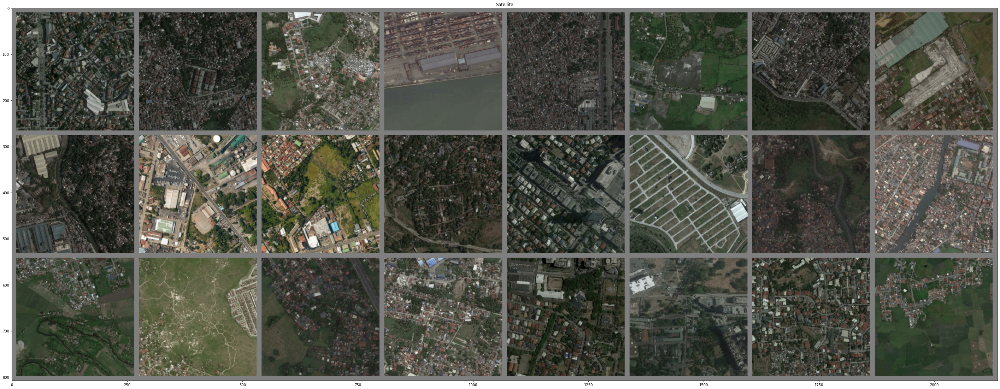

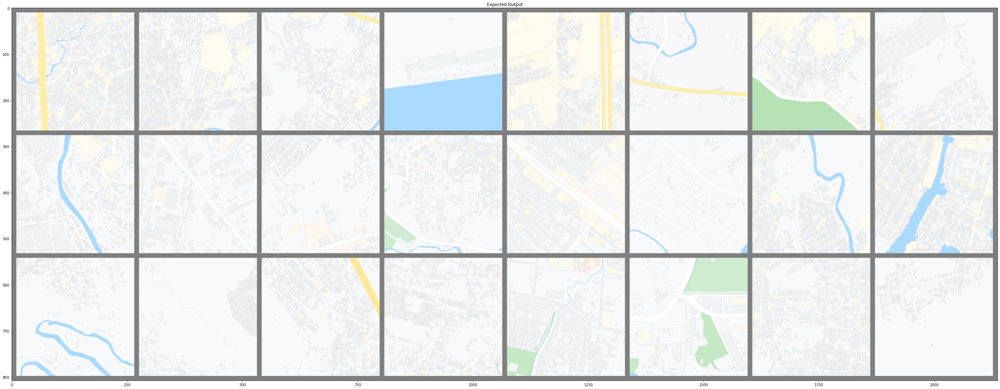

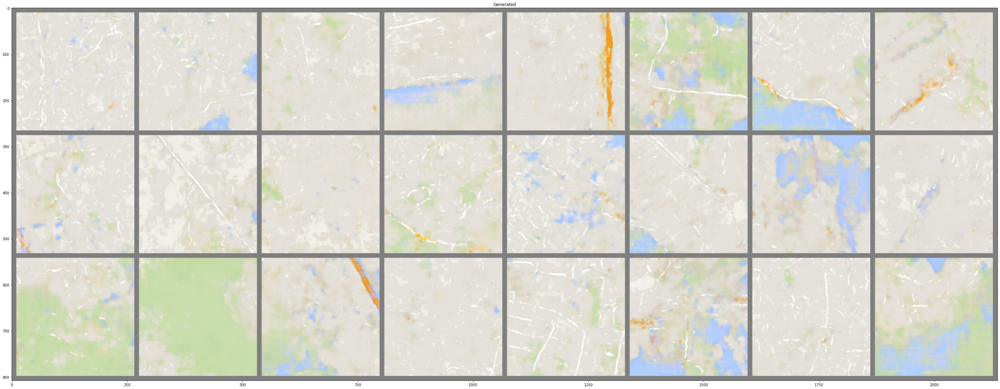

In [61]:
display(HTML('''<center style="font-size:12px;font-style:default;"><b>
Figure 1. Pre-trained model image results. 
(Top) Source Images (Middle) Expected Images (Top) Resulting Images
</b></center>'''))

display(Image(filename="1a.png"))
display(Image(filename="1b.png"))
display(Image(filename="1c.png"))

<h3>II. Image Scraping (Dataset)</h3>

<p style="text-align:justify">Due to the results of the pre-trained model, another model will be trained based on local satellite and map images instead. The images to be used as training data were scraped from the Google Static Maps API wherein pairs of satellite and road map images are concatenated side by side into a single image. [3] There were 6 metropolitan areas used for the scraping namely Metro Manila, Naga, Iloilo, Cebu, Davao, and Cagayan de Oro.  See the supplementary notebook on image scraping for the code reference. A total of 1000 images were downloaded, taking 800 images as the training set and 200 as the test dataset.</p>

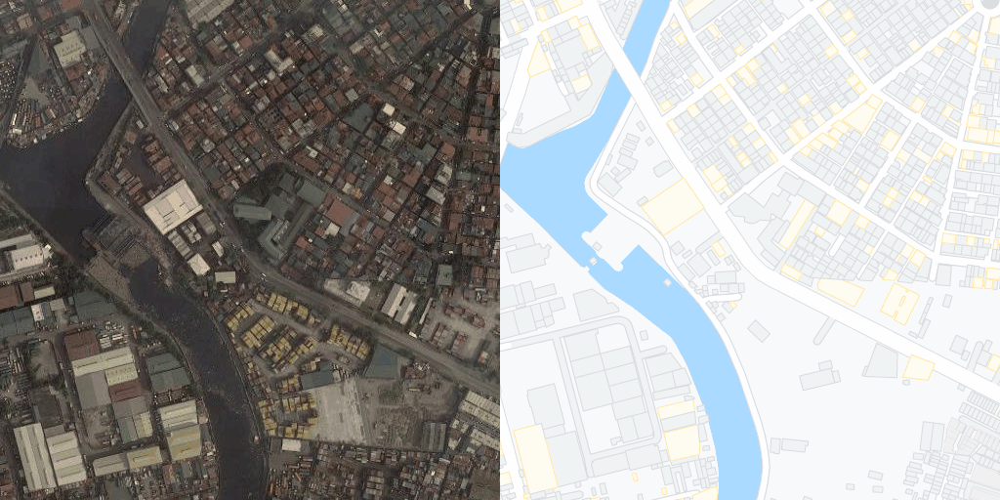

In [62]:
display(HTML('''<center style="font-size:12px;font-style:default;"><b>
Figure 2. Sample Scraped Training Image
</b></center>'''))

display(Image(filename="sample.png")) #sample scraped image

<h3>III. Model Training (Sat2Map)</h3>

<p style="text-align:justify">The models were then trained initially for satellite to map conversion. The GAN model contains two main components, the generator, and the discriminator. In general, a generator outputs fake images while the discriminator tries to classify if these are real or fake.</p>

<b>A. Generator</b>

In [16]:
# load models

image_shape = (256,256,3)

d_model = define_discriminator(image_shape)
g_model = define_generator(image_shape)
gan_model = define_gan(g_model, d_model, image_shape)

<p style="text-align:justify">They are trained and updated via losses wherein the generator is updated by the adversarial loss from the discriminator that helps the generator create better fake images and an L1 loss which is measured between the fake image and the expected output. This helps the generator create better image translations. Meanwhile the discriminator is directly updated via its own loss determined from the ability to determine the fake from the real image.</p>

<p style="text-align:justify">The generator is like an autoencoder which asks all information to go through the bottleneck, when down sampled by the encoder and up sampled by the decoder. But since this can potentially cause loss of some low-level information during transformation, there was a slight modification.  The generator was converted into a U-net which allows the passing of lower-level information across the network without going thru the bottleneck. This information transfer is done using skip connections that are added connecting the encoding and decoding layers. Refer to the diagram in Figure 3.</p>

<p style="text-align:justify">The encoder and decoder part has convolutional layers with batch normalization and a ReLu activation function. Meanwhile the decoder also has dropout layers and skip connections. The overall activation for the generator is tanh.</p>


In [14]:
g_model.summary()

Model: "model_4"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_7 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_20 (Conv2D)             (None, 128, 128, 64  3136        ['input_7[0][0]']                
                                )                                                                 
                                                                                                  
 leaky_re_lu_17 (LeakyReLU)     (None, 128, 128, 64  0           ['conv2d_20[0][0]']              
                                )                                                           

<b>B. Discriminator</b>

<p style="text-align:justify">The discriminator determines the likelihood of the image being fake. It is given an original and a target image and it must be able to detect if the target is a transformation of the original image. Its architecture is based on the final effective receptive field of the model. In this implementation a 70x70 patch is used which is also known as the PatchGAN model. Based on experimentation from literature, instead of scanning the whole image, it is better to do it by patches and previous researchers’ results show that 70x70 is a good patch size. The discriminator covers the high frequency corrections to the generator while the low frequency ones are managed by the L1 loss. The optimization via binary cross entropy loss is halved in order for the generator to keep up as the discriminator has the tendency to learn faster. </p>

<p style="text-align:justify">The discriminator has convolutional layers with batch normalization and a LeakyReLu activation function. The overall activation for the generator is sigmoid. </p>

In [15]:
d_model.summary()

Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_5 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 input_6 (InputLayer)           [(None, 256, 256, 3  0           []                               
                                )]                                                                
                                                                                                  
 concatenate_8 (Concatenate)    (None, 256, 256, 6)  0           ['input_5[0][0]',                
                                                                  'input_6[0][0]']          

<b>C. GAN</b>

<p style="text-align:justify">The GAN model is the combination of the two parts which uses Adam optimizer and 0.0002 learning rate. The loss functions are binary cross entropy for the adversarial loss and mae for the L1 loss. The model was trained using 800 images and it ran through 200 epochs. A model per 20 epochs was saved. The total training run time was 15 hours.</p>

<h3>IV. Model Training (Map2Sat)</h3>

<p style="text-align:justify">Another model was trained which is based on the reverse of the function of the first model, this time the input image is the road map image, and the output will be a remake of the satellite image. The only difference was the reversal of the input and output training images, and no other changes were done on the model’s architecture. This model was trained using 800 images and ran through 100 epochs. The training run time was 8 hours.</p>

<h2>Results</h2>

<h3>I. Sat2Map Results</h3>

<p style="text-align:justify">For the Sat2Map results, several models were tested to see which one works best and according to some perceptual evaluation, the latest model was working best which is trained up to 200 epochs. It must be noted that the nature of this GAN model is not determined by the number of epochs alone. We can see at the Figure 3 below that the latest models at Image 5 has the best result.</p>

Image 1


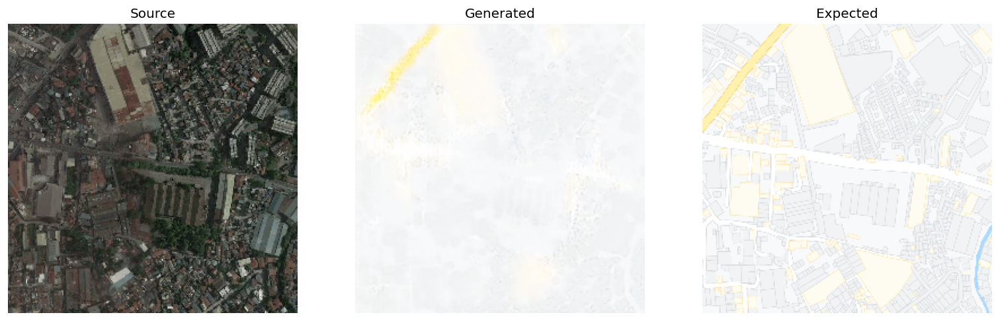

Image 2


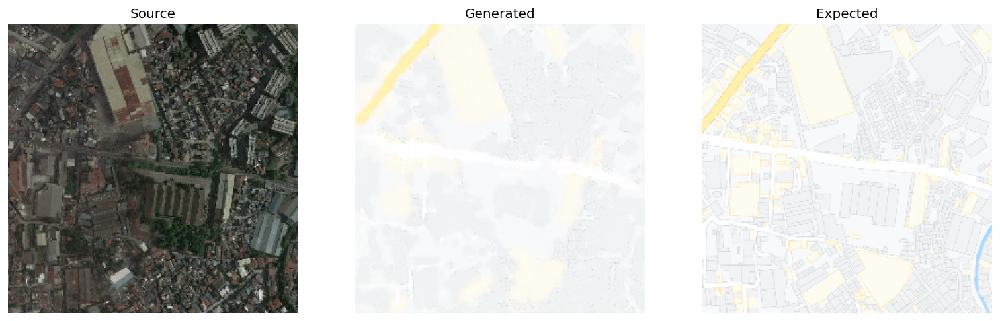

Image 3


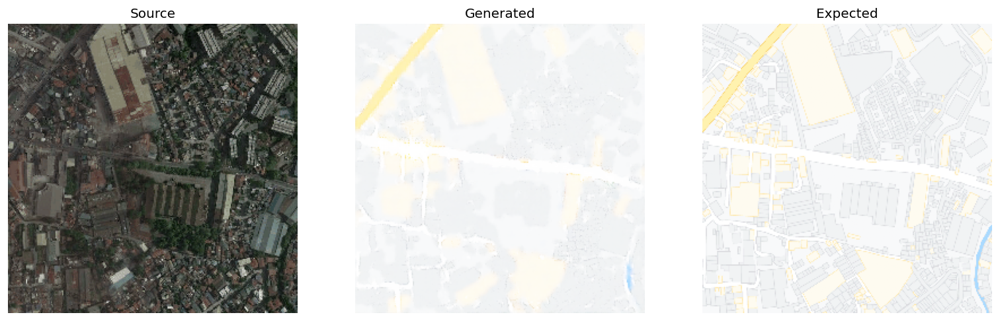

Image 4


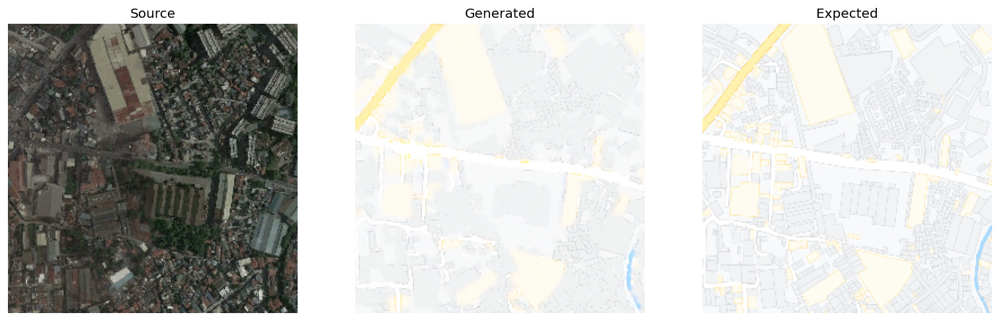

Image 5


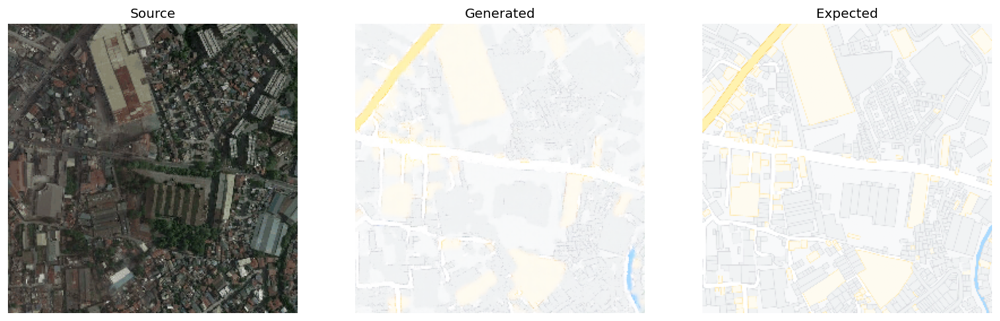

In [72]:
# Image Output Progression Sat2Map

[X1, X2] = load_real_samples('val.npz')

# model progression
model_list = ['normal_loop04.h5', 'normal_loop08.h5',
              'normal_loop12.h5', 'normal_loop16.h5',
              'normal_loop20.h5']

display(HTML('''<center style="font-size:12px;font-style:default;"><b>
Figure 3. Sat2Map Progression Comparison. Image 1 to 5 pertaining to 40, 80, 
120, 160 and 200 epoch results.
</b></center>'''))

for idx, file in enumerate(model_list):
    # load model
    model = load_model(file)
    
    # select random example
    ix = [200] # randint(0, len(X1), 1)
    src_image, tar_image = X1[ix], X2[ix]
    
    # generate image from source
    gen_image = model.predict(src_image)
    
    # plot all three images
    print("Image " + str(idx+1))
    plot_images(src_image, gen_image, tar_image)

<p style="text-align:justify">Other results can be seen below in Figure 4. The details of the maps generated are coming together but are noticeably not yet at par with the original image.  The streets are not as defined specially for the smaller ones but it looks like because the it has a difficult time distinguishing those specific features from the satellite image because of other features obstructing them.</p>

Image 1


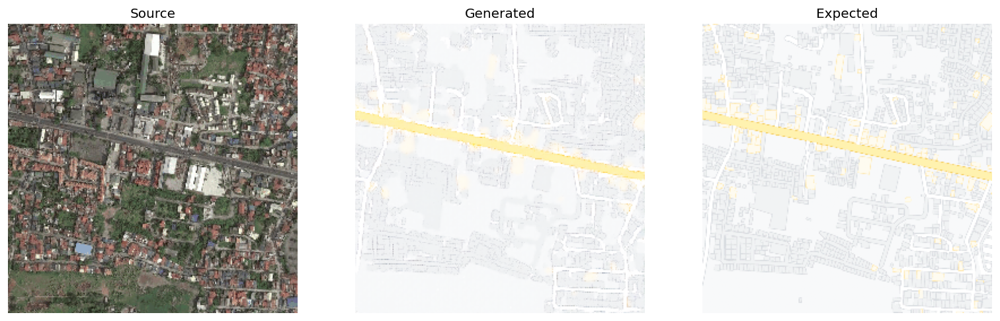

Image 2


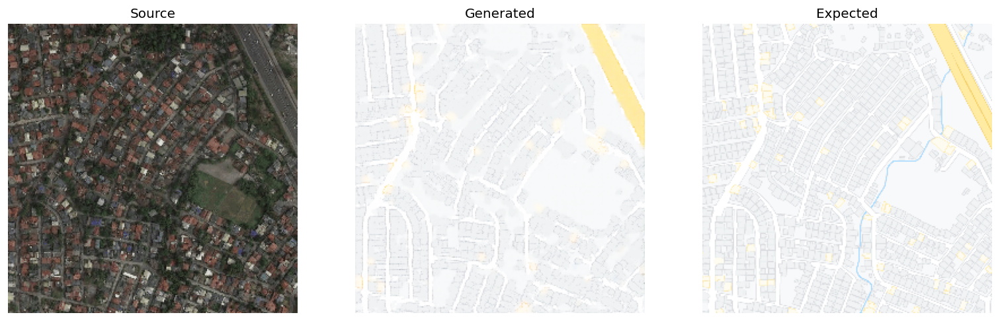

Image 3


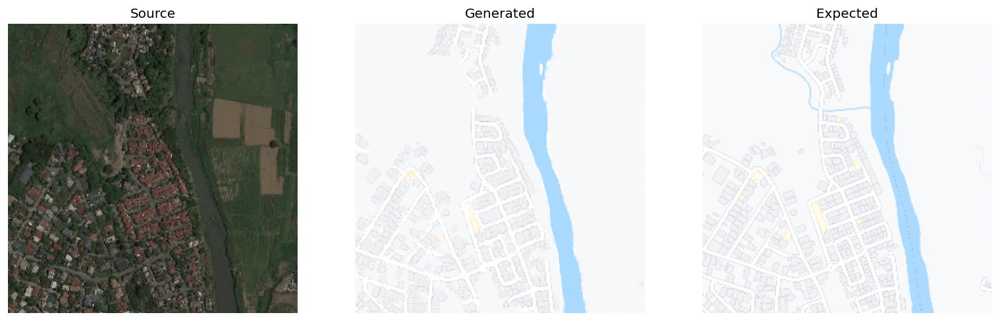

Image 4


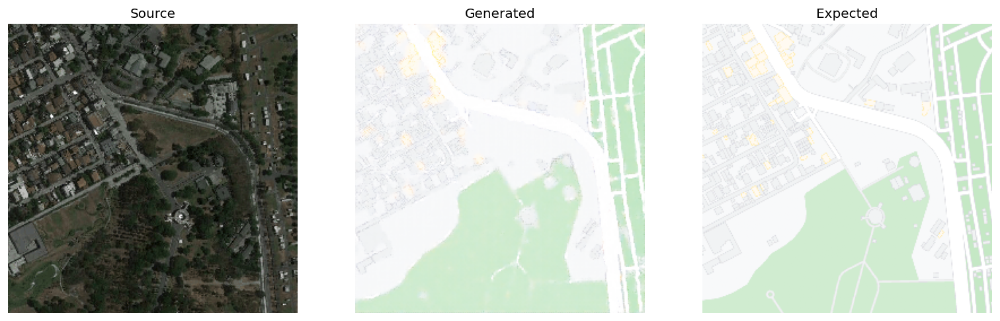

Image 5


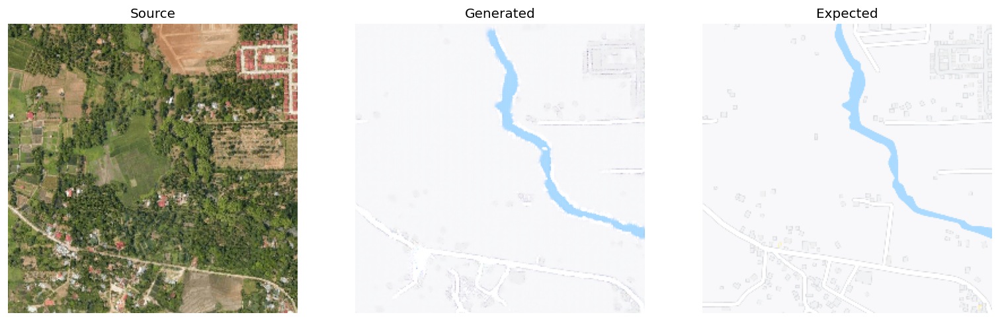

In [70]:
# Image Output Samples Sat2Map

# load model
model = load_model('normal_loop20.h5')

# load dataset
[X1, X2] = load_real_samples('val.npz')

display(HTML('''<center style="font-size:12px;font-style:default;"><b>
Figure 4. Sat2Map Example Outputs
</b></center>'''))

for i in range(0,5):
    # select random example
    ix = randint(0, len(X1), 1)
    src_image, tar_image = X1[ix], X2[ix]
    
    # generate image from source
    gen_image = model.predict(src_image)
    
    # plot all three images
    print("Image " + str(i+1))
    plot_images(src_image, gen_image, tar_image);

<h3>II. Map2Sat Results</h3>

<p style="text-align:justify">Several models were tested to see which one works best and according to some perceptual evaluation, the first model was working best which is trained up to 20 epochs. It must be noted that the nature of this GAN model is not determined by the number of epochs alone. The problem for the map2sat model though is that as the number of epochs increased, the produced image gets blurry as seen in Figure 5.</p>

Image 1


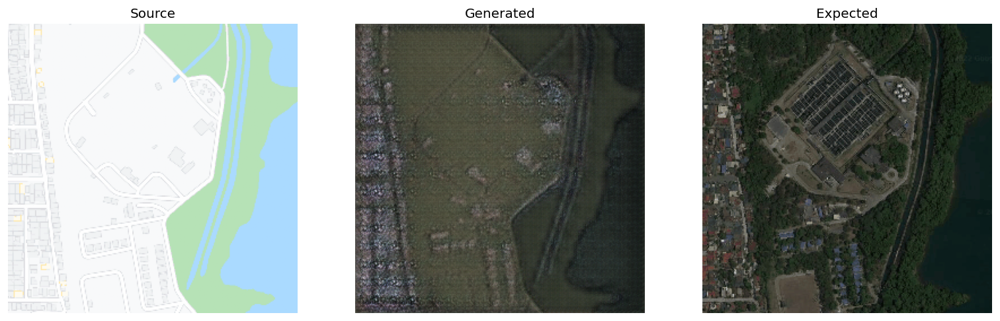

Image 2


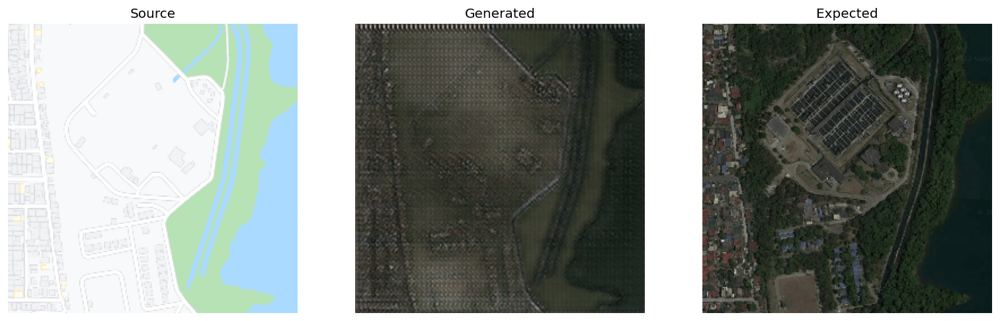

Image 3


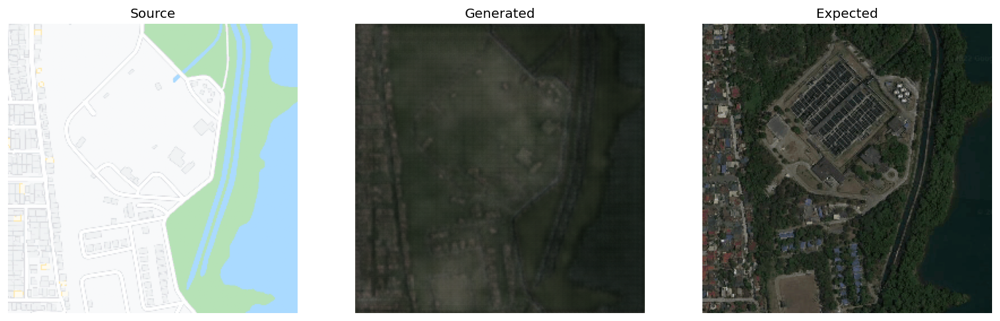

Image 4


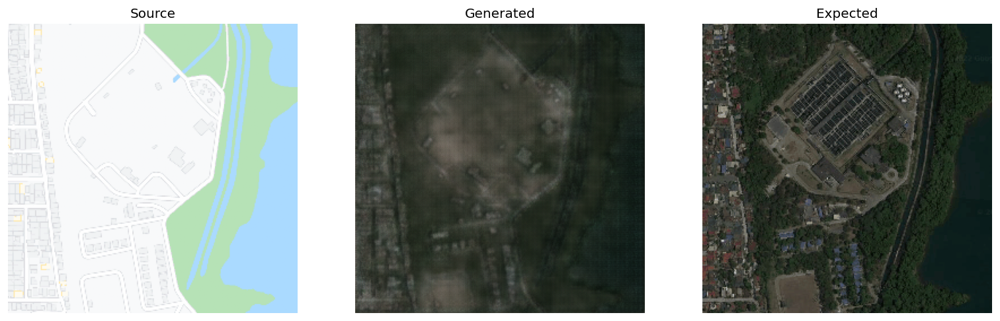

Image 5


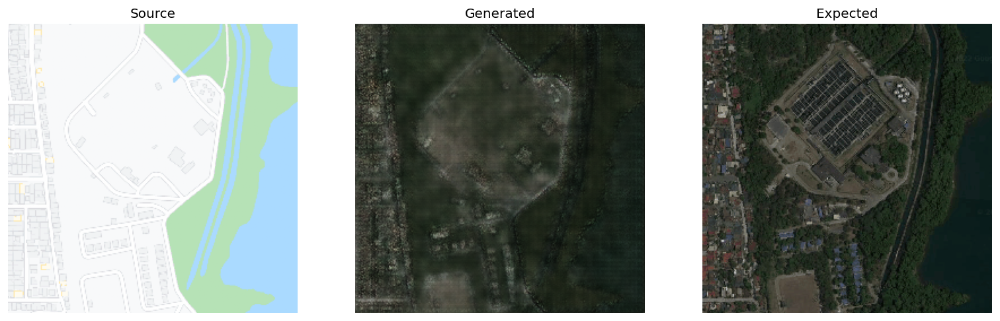

In [73]:
# Image Output Progression Map2Sat

# load dataset
[X2, X1] = load_real_samples('val.npz')

# model progression
model_list = ['reverse_loop01.h5', 'reverse_loop02.h5', 'reverse_loop03.h5', 
              'reverse_loop04.h5', 'reverse_loop05.h5']

display(HTML('''<center style="font-size:12px;font-style:default;"><b>
Figure 5. Map2Sat Progression Comparison. Image 1 to 5 pertaining to 20, 40, 
60, 80 and 100 epoch results.
</b></center>'''))

for idx, file in enumerate(model_list):
    # load model
    model = load_model(file)
    
    # select random example
    ix = [405] # randint(0, len(X1), 1)
    src_image, tar_image = X1[ix], X2[ix]
    
    # generate image from source
    gen_image = model.predict(src_image)
    
    # plot all three images
    print("Image " + str(idx+1))
    plot_images(src_image, gen_image, tar_image)


<p style="text-align:justify">Map2Sat output images are also interesting if you look closely in the example below in Figure 6, the features of the generated satellite images are really based on the map features, some even highlighting features seen in the map but not clearly seen in the original satellite image.</p>

Image 1


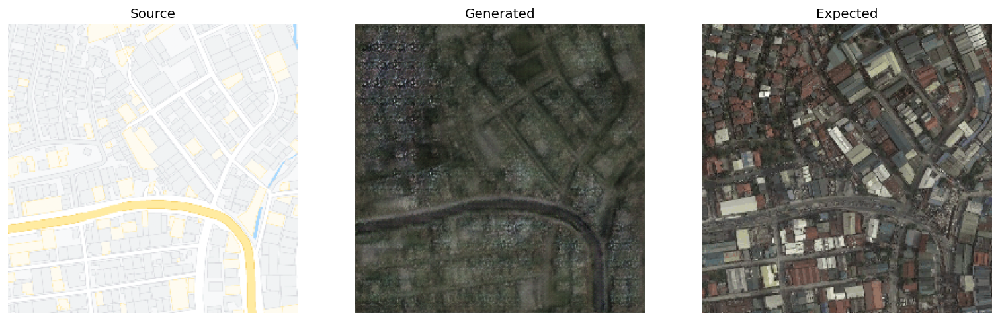

Image 2


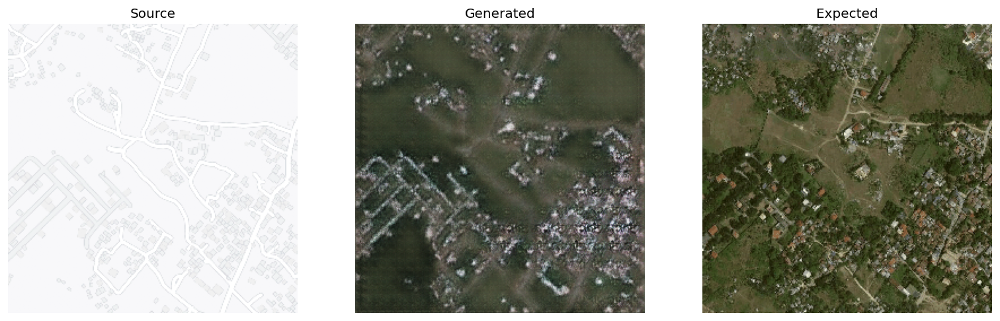

Image 3


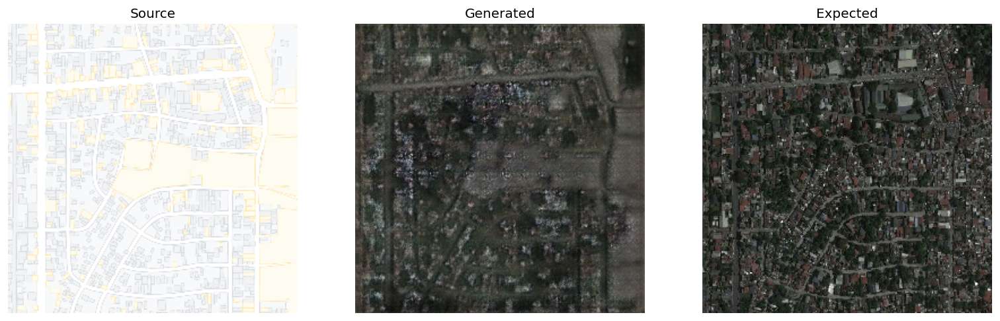

Image 4


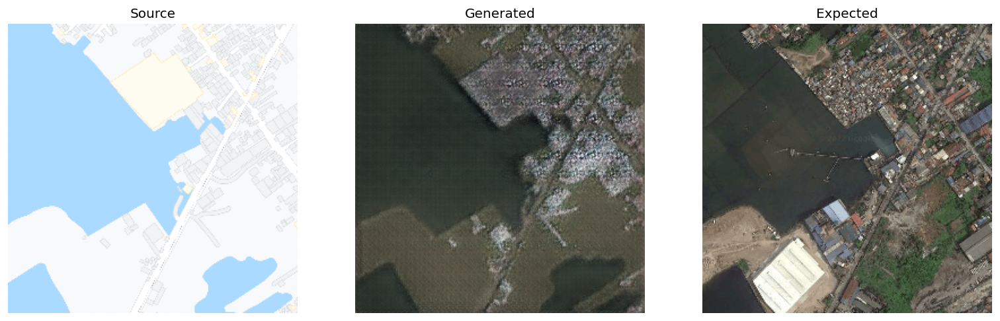

Image 5


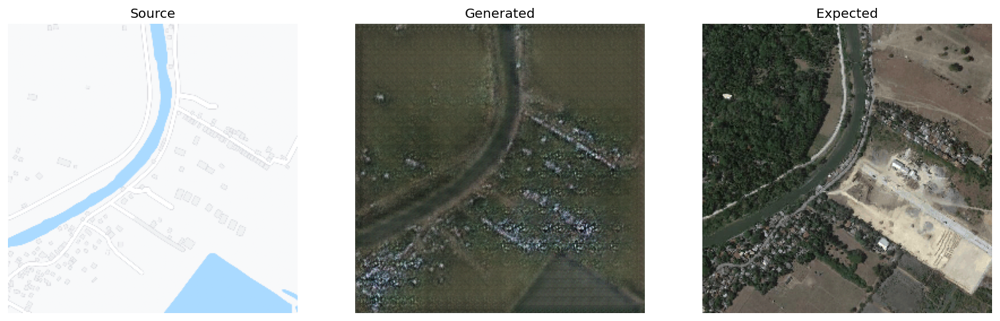

In [68]:
# Image Output Samples Map2Sat

model = load_model('reverse_loop01.h5')

# load dataset
[X2, X1] = load_real_samples('val.npz')

display(HTML('''<center style="font-size:12px;font-style:default;"><b>
Figure 6. Map2Sat Example Outputs
</b></center>'''))

for i in range(0,5):
    # select random example
    ix = randint(0, len(X1), 1)
    src_image, tar_image = X1[ix], X2[ix]
    
    # generate image from source
    gen_image = model.predict(src_image)
    
    # plot all three images
    print("Image " + str(i+1))
    plot_images(src_image, gen_image, tar_image)

<h2>Recommendations</h2>

<p style="text-align:justify">For the recommendation, we can still try to continue training it to higher epochs since the model is still getting better particularly for our Sat2Map model. However, we can also do the same for the Map2Sat model although the result with higher epochs seems to be becoming blurry. We can also introduce more training image and see the effect on the models.</p>

<p style="text-align:justify">Changes to the architecture can also be done, maintaining the u-net for the generator but trying out other loss metrics and activation function can be used. The discriminator’s patch size scanning can be changed as well.</p>

<p style="text-align:justify">Some evaluation metrics can be deployed as a substitute to perceptual evaluations. Some literature use Amazon Mechanical Turk which is a crowdsourcing platform that is used to outsource processes or jobs which can be done virtually. So instead of a personal assessment on the output images, this platform can be used in order to have other people do it. Also, a semantics classifier called FCN-8s can be explored and trained with the same data in order to produce a FCN score.</p>

<p style="text-align:justify">Lastly, is that we can also use MAPGan, which includes a classifier for the type of map. One will be able to produce maps images based on different maps styles and not just limited to the google maps format. Training will be longer as several types of map styles will be included.</p>

<h2>References</h>

[1] https://machinelearningmastery.com/how-to-develop-a-pix2pix-gan-for-image-to-image-translation/

[2] https://github.com/anh-nn01/Satellite-Imagery-to-Map-Translation-using-Pix2Pix-GAN-framework

[3] https://github.com/taesungp/larger-google-sat2maps-dataset

[4] https://www.codegrepper.com/code-examples/python/tensorflow+disable+warnings

[5] https://medium.com/vooban-ai/satellite-image-segmentation-a-workflow-with-u-net-7ff992b2a56e

[6] https://arxiv.org/abs/1611.07004